**Importing the necessary libraries**

In [1]:
!pip install pycaret
!pip install pycaret AutoViz
import pandas as pd
import numpy as np
import pycaret
import autoviz
import pandas_profiling
from pycaret.regression import *


     |████████████████████████████████| 256kB 24.0MB/s 
     |████████████████████████████████| 174kB 47.5MB/s 
     |████████████████████████████████| 157.5MB 93kB/s 
     |████████████████████████████████| 6.8MB 44.2MB/s 
     |████████████████████████████████| 1.6MB 54.9MB/s 
     |████████████████████████████████| 1.8MB 41.8MB/s 
     |████████████████████████████████| 276kB 56.2MB/s 
     |████████████████████████████████| 102kB 14.8MB/s 
     |████████████████████████████████| 266kB 51.2MB/s 
     |████████████████████████████████| 13.9MB 258kB/s 
     |████████████████████████████████| 66.3MB 50kB/s 
     |████████████████████████████████| 2.1MB 39.3MB/s 
     |████████████████████████████████| 3.1MB 43.4MB/s 
     |████████████████████████████████| 71kB 9.5MB/s 
     |████████████████████████████████| 604kB 52.3MB/s 
     |████████████████████████████████| 337kB 56.4MB/s 
     |████████████████████████████████| 163kB 56.2MB/s 
     |████████████████████████████████| 1.1MB 49.5M

**Loading the dataset**

In [2]:
df1=pd.read_csv("/content/Bengaluru_House_Data.csv")
df1

,area_type,availability,location,size,society,total_sqft,bath,balcony,price
0,Super built-up Area,19-Dec,Electronic City Phase II,2 BHK,Coomee,1056,2.0,1.0,39.07
1,Plot Area,Ready To Move,Chikka Tirupathi,4 Bedroom,Theanmp,2600,5.0,3.0,120.00
2,Built-up Area,Ready To Move,Uttarahalli,3 BHK,NaN,1440,2.0,3.0,62.00
3,Super built-up Area,Ready To Move,Lingadheeranahalli,3 BHK,Soiewre,1521,3.0,1.0,95.00
4,Super built-up Area,Ready To Move,Kothanur,2 BHK,NaN,1200,2.0,1.0,51.00
...,...,...,...,...,...,...,...,...,...
13315,Built-up Area,Ready To Move,Whitefield,5 Bedroom,ArsiaEx,3453,4.0,0.0,231.00
13316,Super built-up Area,Ready To Move,Richards Town,4 BHK,NaN,3600,5.0,NaN,400.00
13317,Built-up Area,Ready To Move,Raja Rajeshwari Nagar,2 BHK,Mahla T,1141,2.0,1.0,60.00
13318,Super built-up Area,18-Jun,Padmanabhanagar,4 BHK,SollyCl,4689,4.0,1.0,488.00


Before dig deep let's specify our objective.Here our objective is to predict the Bengaluru House Price.

**Removing the duplicates**

In [3]:
df2=pd.DataFrame.drop_duplicates(df1)

In [4]:
df2.shape

(12791, 9)

In [5]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 12791 entries, 0 to 13318
Data columns (total 9 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   area_type     12791 non-null  object 
 1   availability  12791 non-null  object 
 2   location      12790 non-null  object 
 3   size          12775 non-null  object 
 4   society       7463 non-null   object 
 5   total_sqft    12791 non-null  object 
 6   bath          12718 non-null  float64
 7   balcony       12186 non-null  float64
 8   price         12791 non-null  float64
dtypes: float64(3), object(6)
memory usage: 999.3+ KB


**There are 12791 samples and 9 features. There are few features with missing values.**

**To get a overview of the feature values we generate a profile report**

In [6]:
report=pandas_profiling.ProfileReport(df2)

In [7]:
report

Size column has really weird values 
Drop 'society' feature because 41.3% missing value.
Drop features like 'area_type','availability','society' that are not required to build our model

 size feature shows the number of rooms in  size feature we assume that 2 BHK = 2 Bedroom == 2 RK so takes only number and remove sufix text.Add new feature(integer) for bhk (Bedrooms Hall Kitchen)

In [8]:

df2['size'] = df2['size'].str[:1]

In [9]:
df2.shape

(12791, 9)

In [10]:
df2.dropna(subset=['size'],inplace=True)

In [11]:
df2.shape

(12775, 9)

In [12]:
df2

,area_type,availability,location,size,society,total_sqft,bath,balcony,price
0,Super built-up Area,19-Dec,Electronic City Phase II,2,Coomee,1056,2.0,1.0,39.07
1,Plot Area,Ready To Move,Chikka Tirupathi,4,Theanmp,2600,5.0,3.0,120.00
2,Built-up Area,Ready To Move,Uttarahalli,3,NaN,1440,2.0,3.0,62.00
3,Super built-up Area,Ready To Move,Lingadheeranahalli,3,Soiewre,1521,3.0,1.0,95.00
4,Super built-up Area,Ready To Move,Kothanur,2,NaN,1200,2.0,1.0,51.00
...,...,...,...,...,...,...,...,...,...
13314,Super built-up Area,Ready To Move,Green Glen Layout,3,SoosePr,1715,3.0,3.0,112.00
13315,Built-up Area,Ready To Move,Whitefield,5,ArsiaEx,3453,4.0,0.0,231.00
13316,Super built-up Area,Ready To Move,Richards Town,4,NaN,3600,5.0,NaN,400.00
13317,Built-up Area,Ready To Move,Raja Rajeshwari Nagar,2,Mahla T,1141,2.0,1.0,60.00


In [13]:
df2['bhk'] = df2['size']

In [14]:
df2.dtypes

area_type        object
availability     object
location         object
size             object
society          object
total_sqft       object
bath            float64
balcony         float64
price           float64
bhk              object
dtype: object

In [15]:
df2 = df2.astype({"bhk": float})

In [16]:
df2.dtypes

area_type        object
availability     object
location         object
size             object
society          object
total_sqft       object
bath            float64
balcony         float64
price           float64
bhk             float64
dtype: object

In [17]:
df2

,area_type,availability,location,size,society,total_sqft,bath,balcony,price,bhk
0,Super built-up Area,19-Dec,Electronic City Phase II,2,Coomee,1056,2.0,1.0,39.07,2.0
1,Plot Area,Ready To Move,Chikka Tirupathi,4,Theanmp,2600,5.0,3.0,120.00,4.0
2,Built-up Area,Ready To Move,Uttarahalli,3,NaN,1440,2.0,3.0,62.00,3.0
3,Super built-up Area,Ready To Move,Lingadheeranahalli,3,Soiewre,1521,3.0,1.0,95.00,3.0
4,Super built-up Area,Ready To Move,Kothanur,2,NaN,1200,2.0,1.0,51.00,2.0
...,...,...,...,...,...,...,...,...,...,...
13314,Super built-up Area,Ready To Move,Green Glen Layout,3,SoosePr,1715,3.0,3.0,112.00,3.0
13315,Built-up Area,Ready To Move,Whitefield,5,ArsiaEx,3453,4.0,0.0,231.00,5.0
13316,Super built-up Area,Ready To Move,Richards Town,4,NaN,3600,5.0,NaN,400.00,4.0
13317,Built-up Area,Ready To Move,Raja Rajeshwari Nagar,2,Mahla T,1141,2.0,1.0,60.00,2.0


In [18]:
report=pandas_profiling.ProfileReport(df2)

In [19]:
report

In [20]:
df2.total_sqft.unique()

array(['1056', '2600', '1440', ..., '1133 - 1384', '774', '4689'],
      dtype=object)

Here we are seeing some alphanumeric value value also.So now i am going to make a function which will take the mean when it see range and ignore the alphanumeric value.
There are some range values and values in diff format like sq meter, Perch etc
fetch values which are not integers **bold text**

In [21]:
def is_float(x):
    try:
        float(x)
    except:
        return False
    return True

In [22]:
df2[~df2['total_sqft'].apply(is_float)].head()

,area_type,availability,location,size,society,total_sqft,bath,balcony,price,bhk
30,Super built-up Area,19-Dec,Yelahanka,4,LedorSa,2100 - 2850,4.0,0.0,186.000,4.0
56,Built-up Area,20-Feb,Devanahalli,4,BrereAt,3010 - 3410,NaN,NaN,192.000,4.0
81,Built-up Area,18-Oct,Hennur Road,4,Gollela,2957 - 3450,NaN,NaN,224.500,4.0
122,Super built-up Area,18-Mar,Hebbal,4,SNontle,3067 - 8156,4.0,0.0,477.000,4.0
137,Super built-up Area,19-Mar,8th Phase JP Nagar,2,Vaarech,1042 - 1105,2.0,0.0,54.005,2.0


In [23]:
df2.shape

(12775, 10)

Above shows that total_sqft can be a range (e.g. 2100-2850). For such case best strategy is to convert it into number by spliting it and we can take average of min and max value in the range. There are other cases such as 34.46Sq. Meter which I am going to just drop such corner cases to keep things simple.


In [24]:
def convert_sqft_to_num(x):
    tokens = x.split('-')
    if len(tokens) == 2:
        return (float(tokens[0])+float(tokens[1]))/2
    try:
        return float(x)
    except:
        return None

In [25]:
df3 = df2.copy()
df3.total_sqft = df3.total_sqft.apply(convert_sqft_to_num)
df3 = df3[df3.total_sqft.notnull()]
df3.head(50)

,area_type,availability,location,size,society,total_sqft,bath,balcony,price,bhk
0,Super built-up Area,19-Dec,Electronic City Phase II,2,Coomee,1056.00,2.0,1.0,39.07,2.0
1,Plot Area,Ready To Move,Chikka Tirupathi,4,Theanmp,2600.00,5.0,3.0,120.00,4.0
2,Built-up Area,Ready To Move,Uttarahalli,3,NaN,1440.00,2.0,3.0,62.00,3.0
3,Super built-up Area,Ready To Move,Lingadheeranahalli,3,Soiewre,1521.00,3.0,1.0,95.00,3.0
4,Super built-up Area,Ready To Move,Kothanur,2,NaN,1200.00,2.0,1.0,51.00,2.0
5,Super built-up Area,Ready To Move,Whitefield,2,DuenaTa,1170.00,2.0,1.0,38.00,2.0
6,Super built-up Area,18-May,Old Airport Road,4,Jaades,2732.00,4.0,NaN,204.00,4.0
7,Super built-up Area,Ready To Move,Rajaji Nagar,4,Brway G,3300.00,4.0,NaN,600.00,4.0
8,Super built-up Area,Ready To Move,Marathahalli,3,NaN,1310.00,3.0,1.0,63.25,3.0
9,Plot Area,Ready To Move,Gandhi Bazar,6,NaN,1020.00,6.0,NaN,370.00,6.0


In [26]:
df3.shape

(12729, 10)

In [27]:
report=pandas_profiling.ProfileReport(df3)

In [28]:
report

Adding price per sqft to detect outliers
Add new feature called price per square feet

In [29]:
df4 = df3.copy()
df4['price_per_sqft'] = df4['price']*100000/df4['total_sqft']
df4.head()

,area_type,availability,location,size,society,total_sqft,bath,balcony,price,bhk,price_per_sqft
0,Super built-up Area,19-Dec,Electronic City Phase II,2,Coomee,1056.0,2.0,1.0,39.07,2.0,3699.810606
1,Plot Area,Ready To Move,Chikka Tirupathi,4,Theanmp,2600.0,5.0,3.0,120.00,4.0,4615.384615
2,Built-up Area,Ready To Move,Uttarahalli,3,NaN,1440.0,2.0,3.0,62.00,3.0,4305.555556
3,Super built-up Area,Ready To Move,Lingadheeranahalli,3,Soiewre,1521.0,3.0,1.0,95.00,3.0,6245.890861
4,Super built-up Area,Ready To Move,Kothanur,2,NaN,1200.0,2.0,1.0,51.00,2.0,4250.000000


Examine locations which is a categorical variable. We need to apply dimensionality reduction technique here to reduce number of locations

In [30]:
#AutoViz initilization
from autoviz.AutoViz_Class import AutoViz_Class
#Instantiate the AutoViz class
AV=AutoViz_Class()

Imported AutoViz_Class version: 0.0.81. Call using:
    from autoviz.AutoViz_Class import AutoViz_Class
    AV = AutoViz_Class()
    AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0,
                            lowess=False,chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30)
Note: verbose=0 or 1 generates charts and displays them in your local Jupyter notebook.
      verbose=2 saves plots in your local machine under AutoViz_Plots directory and does not display charts.


Shape of your Data Set: (12729, 6)
############## C L A S S I F Y I N G  V A R I A B L E S  ####################
Classifying variables in data set...
    Number of Numeric Columns =  4
    Number of Integer-Categorical Columns =  0
    Number of String-Categorical Columns =  0
    Number of Factor-Categorical Columns =  0
    Number of String-Boolean Columns =  0
    Number of Numeric-Boolean Columns =  0
    Number of Discrete String Columns =  1
    Number of NLP String Columns =  0
    Number of Date Time Columns =  0
    Number of ID Columns =  0
    Number of Columns to Delete =  0
    5 Predictors classified...
        This does not include the Target column(s)
        1 variables removed since they were ID or low-information variables

################ Regression VISUALIZATION Started #####################


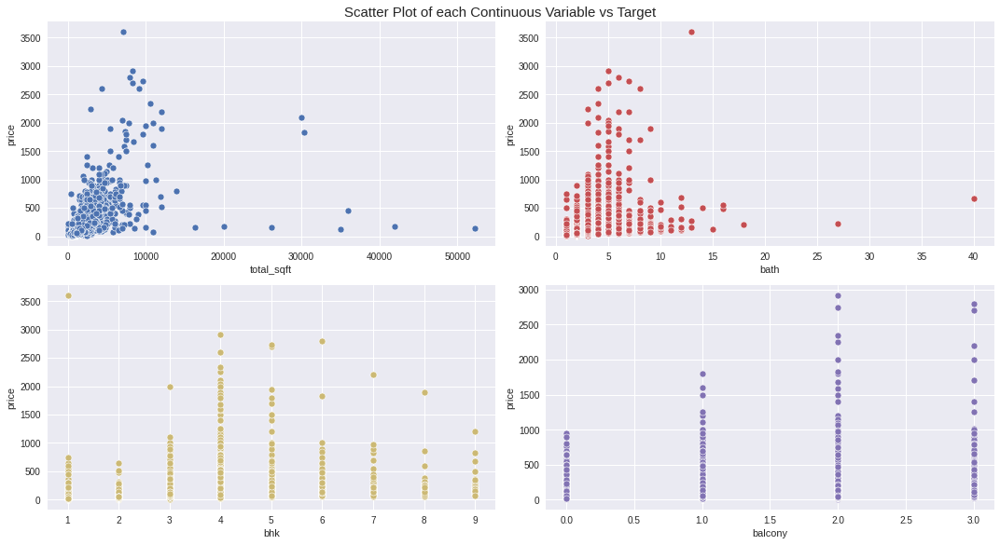

Number of All Scatter Plots = 10


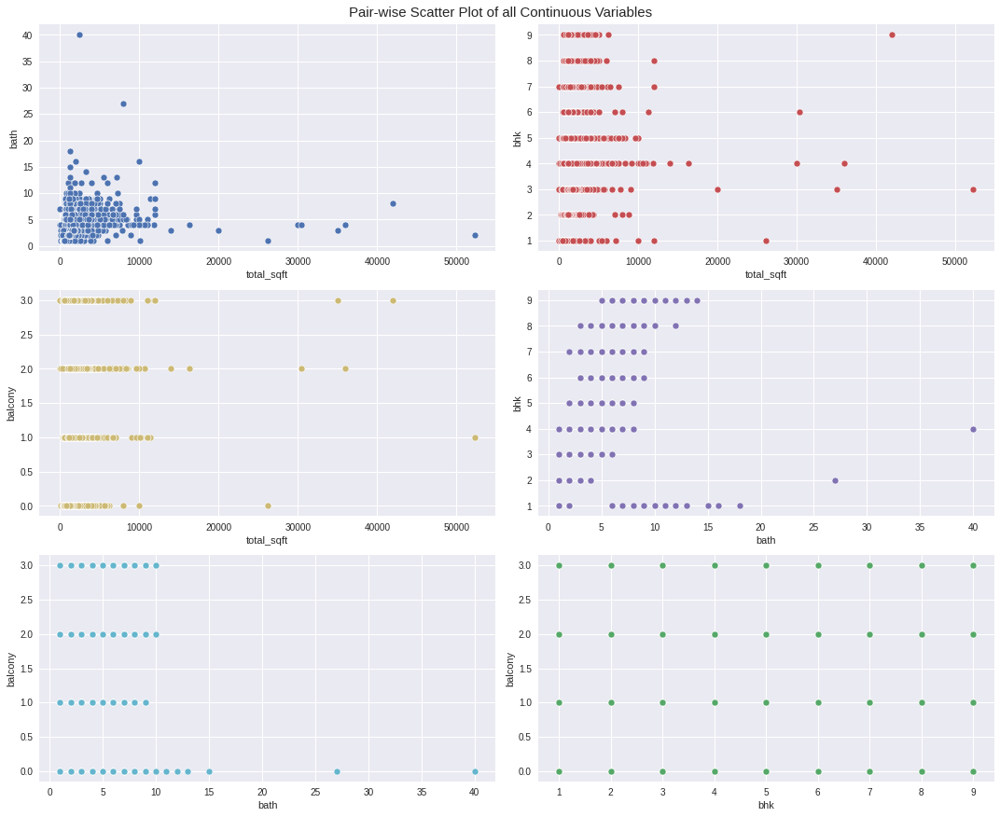

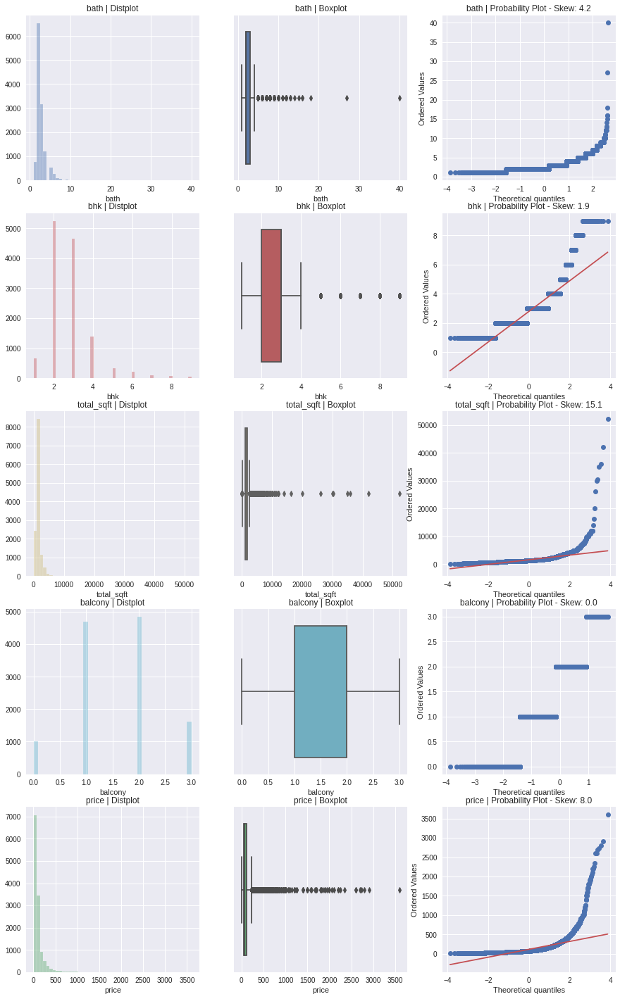

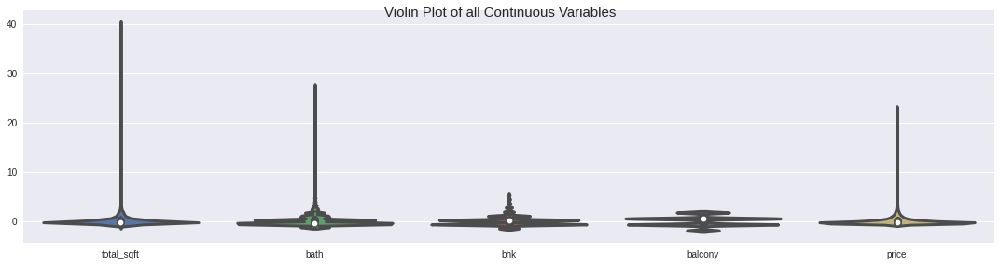

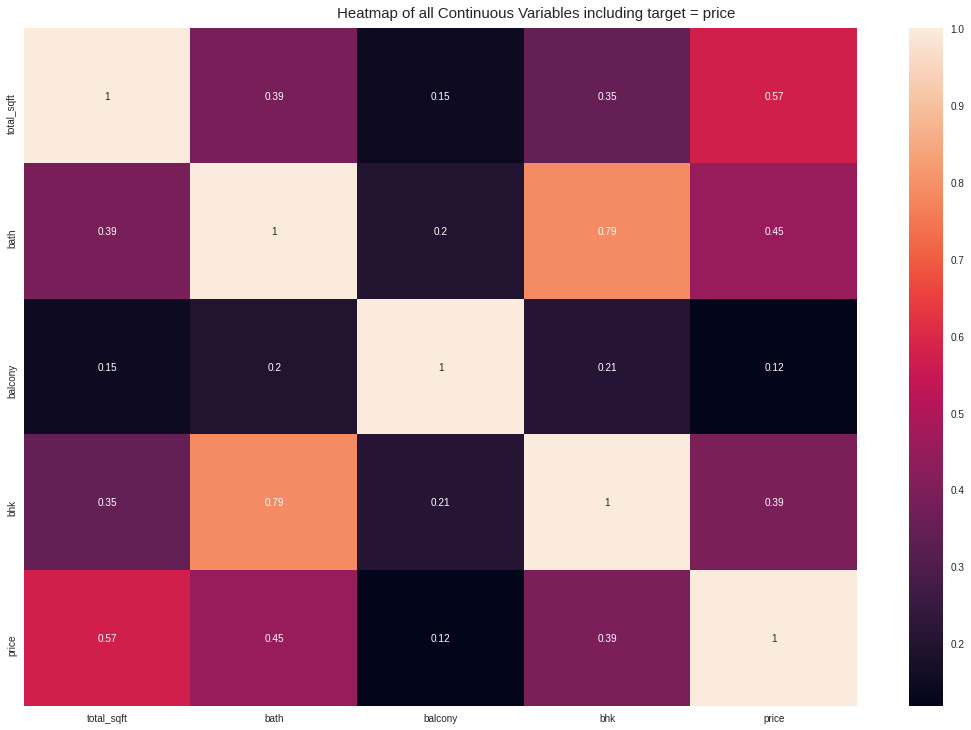

No categorical or boolean vars in data set. Hence no pivot plots...
No categorical or numeric vars in data set. Hence no bar charts.
All Plots done
Time to run AutoViz (in seconds) = 8.872

 ###################### VISUALIZATION Completed ########################


,total_sqft,bath,balcony,bhk,price
0,1056.0,2.0,1.0,2.0,39.07
1,2600.0,5.0,3.0,4.0,120.00
2,1440.0,2.0,3.0,3.0,62.00
3,1521.0,3.0,1.0,3.0,95.00
4,1200.0,2.0,1.0,2.0,51.00
...,...,...,...,...,...
13314,1715.0,3.0,3.0,3.0,112.00
13315,3453.0,4.0,0.0,5.0,231.00
13316,3600.0,5.0,NaN,4.0,400.00
13317,1141.0,2.0,1.0,2.0,60.00


In [31]:
df_auto=df4.drop(['area_type', 'availability','society','price_per_sqft','size'], axis=1)
AV.AutoViz(filename='', sep=',', depVar='price', dfte=df_auto)

In [32]:
#df4.location = df4.location.apply(lambda x: x.strip())
location_stats = df4['location'].value_counts(ascending=False)
location_stats

Whitefield               520
Sarjapur  Road           377
Electronic City          287
Kanakpura Road           247
Thanisandra              228
                        ... 
Dhanalakshmi Layout        1
Sri Kanteshwara Nagar      1
Bharat Nagar               1
Raja Rajashweri Nagar      1
Rajagopala Nagar           1
Name: location, Length: 1298, dtype: int64

In [33]:
len(location_stats)

1298

In [34]:
len(location_stats[location_stats>9])

249

In [35]:
len(location_stats[location_stats<10])

1049

Dimensionality Reduction
Any location having less than 10 data points should be tagged as "other" location. This way number of categories can be reduced by huge amount. Later on when we do one hot encoding, it will help us with having fewer dummy columns

In [36]:
location_stats_less_than_10 = location_stats[location_stats<=10]
location_stats_less_than_10

Gunjur Palya             10
Nagappa Reddy Layout     10
Sadashiva Nagar          10
Nagadevanahalli          10
Dodsworth Layout         10
                         ..
Dhanalakshmi Layout       1
Sri Kanteshwara Nagar     1
Bharat Nagar              1
Raja Rajashweri Nagar     1
Rajagopala Nagar          1
Name: location, Length: 1066, dtype: int64

In [37]:
df4.location = df4.location.apply(lambda x: 'other' if x in location_stats_less_than_10 else x)
len(df4.location.unique())

234

In [38]:
df4.location.unique()

array(['Electronic City Phase II', 'Chikka Tirupathi', 'Uttarahalli',
       'Lingadheeranahalli', 'Kothanur', 'Whitefield', 'Old Airport Road',
       'Rajaji Nagar', 'Marathahalli', 'other', '7th Phase JP Nagar',
       'Gottigere', 'Sarjapur', 'Mysore Road', 'Bisuvanahalli',
       'Raja Rajeshwari Nagar', 'Kengeri', 'Binny Pete', 'Thanisandra',
       'Bellandur', 'Electronic City', 'Ramagondanahalli', 'Yelahanka',
       'Hebbal', 'Kasturi Nagar', 'Kanakpura Road',
       'Electronics City Phase 1', 'Kundalahalli', 'Chikkalasandra',
       'Murugeshpalya', 'Sarjapur  Road', 'HSR Layout', 'Doddathoguru',
       'KR Puram', 'Bhoganhalli', 'Lakshminarayana Pura', 'Begur Road',
       'Devanahalli', 'Varthur', 'Bommanahalli', 'Gunjur', 'Hegde Nagar',
       'Haralur Road', 'Hennur Road', 'Kothannur', 'Kalena Agrahara',
       'Kaval Byrasandra', 'ISRO Layout', 'Garudachar Palya', 'EPIP Zone',
       'Dasanapura', 'Kasavanhalli', 'Sanjay nagar', 'Domlur',
       'Sarjapura - Attibele R

In [39]:
df4.head(50)

,area_type,availability,location,size,society,total_sqft,bath,balcony,price,bhk,price_per_sqft
0,Super built-up Area,19-Dec,Electronic City Phase II,2,Coomee,1056.00,2.0,1.0,39.07,2.0,3699.810606
1,Plot Area,Ready To Move,Chikka Tirupathi,4,Theanmp,2600.00,5.0,3.0,120.00,4.0,4615.384615
2,Built-up Area,Ready To Move,Uttarahalli,3,NaN,1440.00,2.0,3.0,62.00,3.0,4305.555556
3,Super built-up Area,Ready To Move,Lingadheeranahalli,3,Soiewre,1521.00,3.0,1.0,95.00,3.0,6245.890861
4,Super built-up Area,Ready To Move,Kothanur,2,NaN,1200.00,2.0,1.0,51.00,2.0,4250.000000
5,Super built-up Area,Ready To Move,Whitefield,2,DuenaTa,1170.00,2.0,1.0,38.00,2.0,3247.863248
6,Super built-up Area,18-May,Old Airport Road,4,Jaades,2732.00,4.0,NaN,204.00,4.0,7467.057101
7,Super built-up Area,Ready To Move,Rajaji Nagar,4,Brway G,3300.00,4.0,NaN,600.00,4.0,18181.818182
8,Super built-up Area,Ready To Move,Marathahalli,3,NaN,1310.00,3.0,1.0,63.25,3.0,4828.244275
9,Plot Area,Ready To Move,other,6,NaN,1020.00,6.0,NaN,370.00,6.0,36274.509804


In [40]:
df4.shape

(12729, 11)

In [41]:
size_stats = df4['size'].value_counts(ascending=False)
size_stats

2    5236
3    4641
4    1394
1     653
5     346
6     220
7      99
8      88
9      52
Name: size, dtype: int64

In [42]:
df4.dtypes

area_type          object
availability       object
location           object
size               object
society            object
total_sqft        float64
bath              float64
balcony           float64
price             float64
bhk               float64
price_per_sqft    float64
dtype: object

Outlier Removal Using Business Logic
As a data scientist when you have a conversation with your business manager (who has expertise in real estate), he will tell you that normally square ft per bedroom is 300 (i.e. 2 bhk apartment is minimum 600 sqft. If you have for example 400 sqft apartment with 2 bhk than that seems suspicious and can be removed as an outlier. We will remove such outliers by keeping our minimum thresold per bhk to be 300 sqft

In [43]:
df4[df4.total_sqft/df4.bhk<300].head()

,area_type,availability,location,size,society,total_sqft,bath,balcony,price,bhk,price_per_sqft
9,Plot Area,Ready To Move,other,6,NaN,1020.0,6.0,NaN,370.0,6.0,36274.509804
45,Plot Area,Ready To Move,HSR Layout,8,NaN,600.0,9.0,NaN,200.0,8.0,33333.333333
58,Plot Area,Ready To Move,Murugeshpalya,6,NaN,1407.0,4.0,1.0,150.0,6.0,10660.980810
68,Plot Area,Ready To Move,other,8,NaN,1350.0,7.0,0.0,85.0,8.0,6296.296296
70,Plot Area,Ready To Move,other,3,NaN,500.0,3.0,2.0,100.0,3.0,20000.000000


In [44]:
df4.shape

(12729, 11)

In [45]:
df5 = df4[~(df4.total_sqft/df4.bhk<300)]
df5.shape

(12011, 11)

In [46]:
df6 = df5[~(df5.total_sqft/df5.bhk>1200)]
df6.shape

(11810, 11)

In [47]:
df5 = df4[~(df4.total_sqft/df4.bhk<300)]
df6 = df5[~(df5.total_sqft/df5.bhk>1200)]

no of bathroom should not be greater than no of bed rooms and aroud 98% of data values in columns 'bhk' and 'bath' lies in the range 1-6 sowe can remove the rows which is having value greater than 6

In [48]:
bath_stats = df6['bath'].value_counts(ascending=False)
bath_stats

2.0     6446
3.0     3024
4.0      966
1.0      703
5.0      367
6.0      155
7.0       46
8.0       26
9.0       11
10.0       4
11.0       2
18.0       1
40.0       1
14.0       1
Name: bath, dtype: int64

In [49]:
df7=df6[df6.bath<7]
df7.shape

(11661, 11)

In [50]:
bhk_stats = df7['bhk'].value_counts(ascending=False)
bhk_stats

2.0    5184
3.0    4481
4.0    1137
1.0     591
5.0     173
6.0      73
7.0      15
8.0       7
Name: bhk, dtype: int64

In [51]:
df8=df7[df7.bhk<7]
df8.shape

(11639, 11)

In [52]:
df7=df6[df6.bath<7]
df8=df7[df7.bhk<7]

nan value rows in location is dropped

In [53]:
df8.dropna(subset = ["location"], inplace=True)

In [54]:
df8.shape

(11638, 11)

Shape of your Data Set: (11638, 6)
############## C L A S S I F Y I N G  V A R I A B L E S  ####################
Classifying variables in data set...
    Number of Numeric Columns =  4
    Number of Integer-Categorical Columns =  0
    Number of String-Categorical Columns =  0
    Number of Factor-Categorical Columns =  0
    Number of String-Boolean Columns =  0
    Number of Numeric-Boolean Columns =  0
    Number of Discrete String Columns =  1
    Number of NLP String Columns =  0
    Number of Date Time Columns =  0
    Number of ID Columns =  0
    Number of Columns to Delete =  0
    5 Predictors classified...
        This does not include the Target column(s)
        1 variables removed since they were ID or low-information variables

################ Regression VISUALIZATION Started #####################


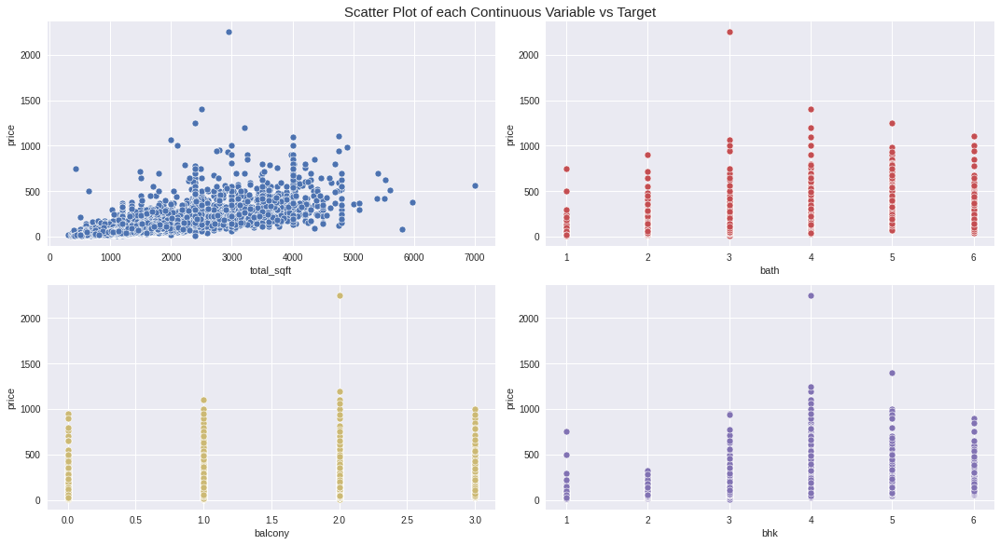

Number of All Scatter Plots = 10


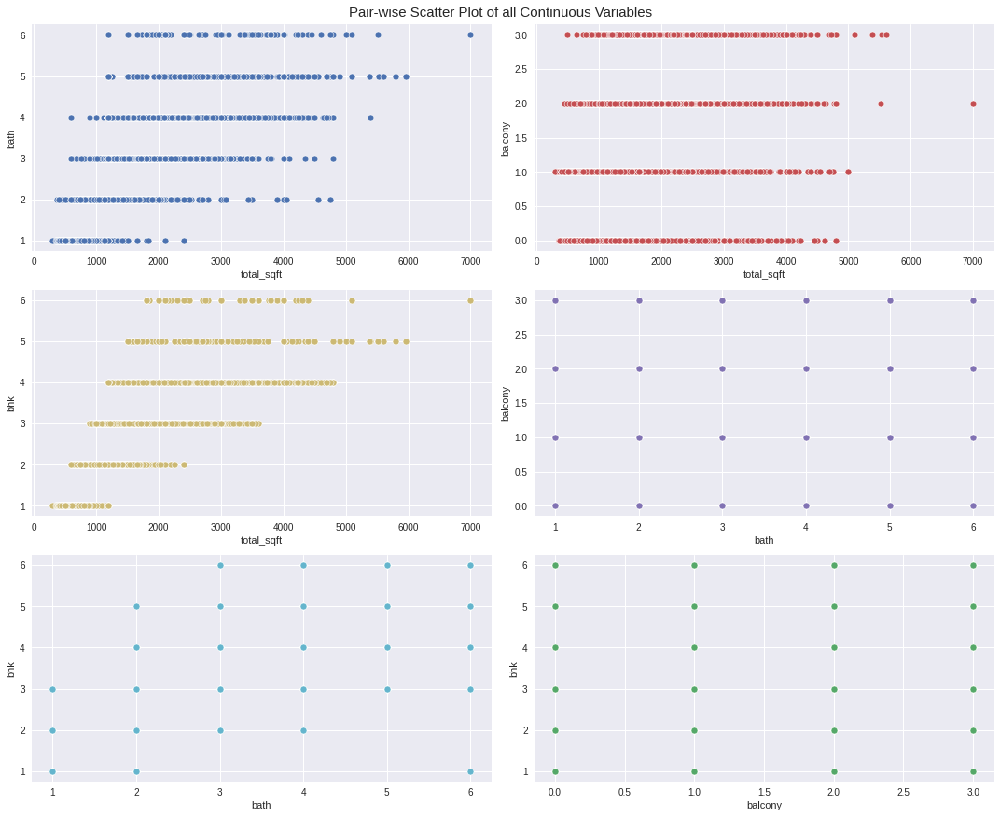

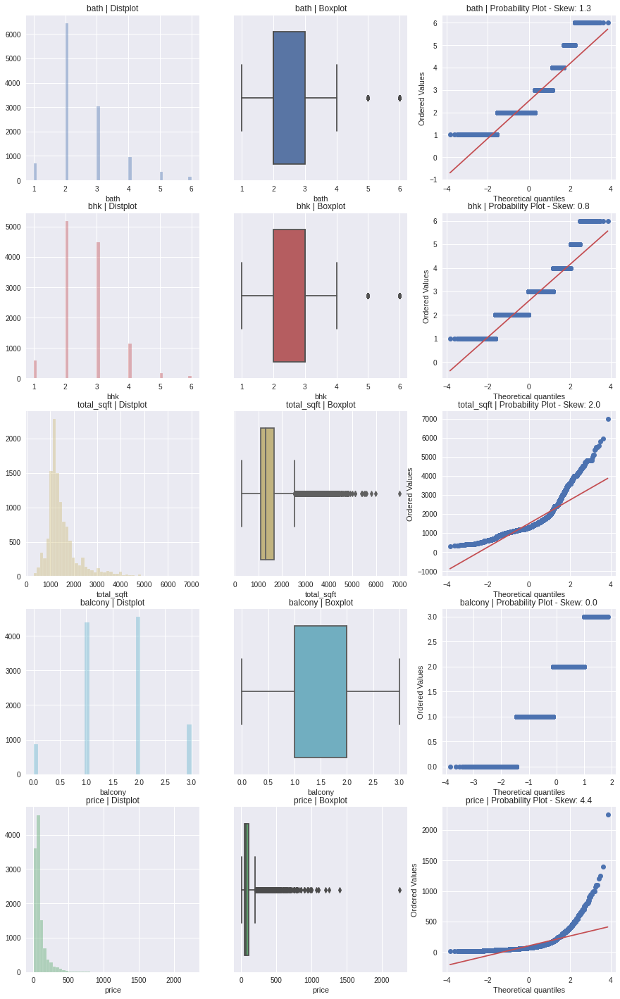

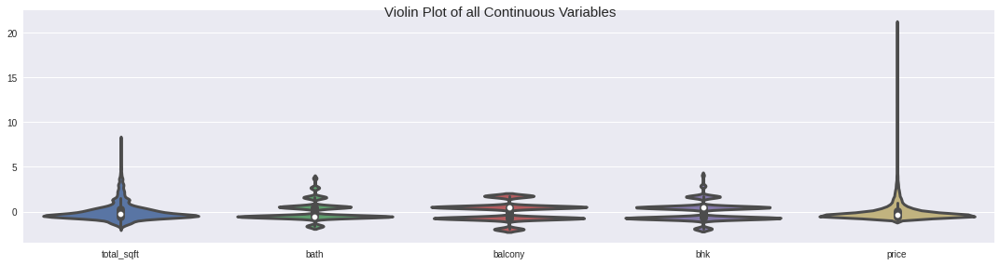

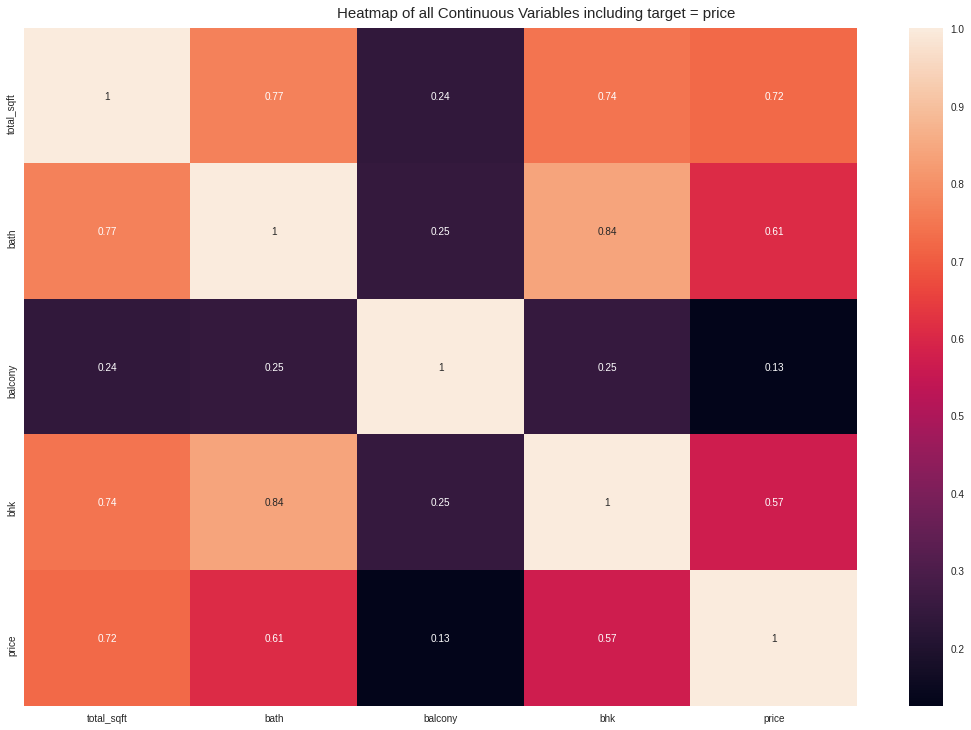

No categorical or boolean vars in data set. Hence no pivot plots...
No categorical or numeric vars in data set. Hence no bar charts.
All Plots done
Time to run AutoViz (in seconds) = 8.192

 ###################### VISUALIZATION Completed ########################


,total_sqft,bath,balcony,bhk,price
0,1056.0,2.0,1.0,2.0,39.07
1,2600.0,5.0,3.0,4.0,120.00
2,1440.0,2.0,3.0,3.0,62.00
3,1521.0,3.0,1.0,3.0,95.00
4,1200.0,2.0,1.0,2.0,51.00
...,...,...,...,...,...
13314,1715.0,3.0,3.0,3.0,112.00
13315,3453.0,4.0,0.0,5.0,231.00
13316,3600.0,5.0,NaN,4.0,400.00
13317,1141.0,2.0,1.0,2.0,60.00


In [55]:
df_auto=df8.drop(['area_type', 'availability','society','price_per_sqft','size'], axis=1)
AV.AutoViz(filename='', sep=',', depVar='price', dfte=df_auto)

In [56]:
report=pandas_profiling.ProfileReport(df8)
report

price per sqft min is 1538.46 and max is 176470, which are impossible for generic model.Outlier Removal Using Business Logic
As a data scientist when you have a conversation with a real estate expert, he said normal price per square ft  is 1500. If you have for example of price per sqft less than that seems suspicious and can be removed as an outlier. We will remove such outliers by keeping our minimum price per square feet to be 1500 sqft

In [57]:
price_per_sqft_stats = df8['price_per_sqft'].value_counts(ascending=False)
price_per_sqft_stats

5000.000000     135
4000.000000     116
6666.666667      64
3500.000000      56
6250.000000      55
               ... 
4108.280255       1
7084.265474       1
5180.374639       1
4742.268041       1
12790.697674      1
Name: price_per_sqft, Length: 7210, dtype: int64

In [58]:
df9=df8.loc[df8['price_per_sqft'] >1500]

Shape of your Data Set: (11632, 6)
############## C L A S S I F Y I N G  V A R I A B L E S  ####################
Classifying variables in data set...
    Number of Numeric Columns =  4
    Number of Integer-Categorical Columns =  0
    Number of String-Categorical Columns =  0
    Number of Factor-Categorical Columns =  0
    Number of String-Boolean Columns =  0
    Number of Numeric-Boolean Columns =  0
    Number of Discrete String Columns =  1
    Number of NLP String Columns =  0
    Number of Date Time Columns =  0
    Number of ID Columns =  0
    Number of Columns to Delete =  0
    5 Predictors classified...
        This does not include the Target column(s)
        1 variables removed since they were ID or low-information variables

################ Regression VISUALIZATION Started #####################


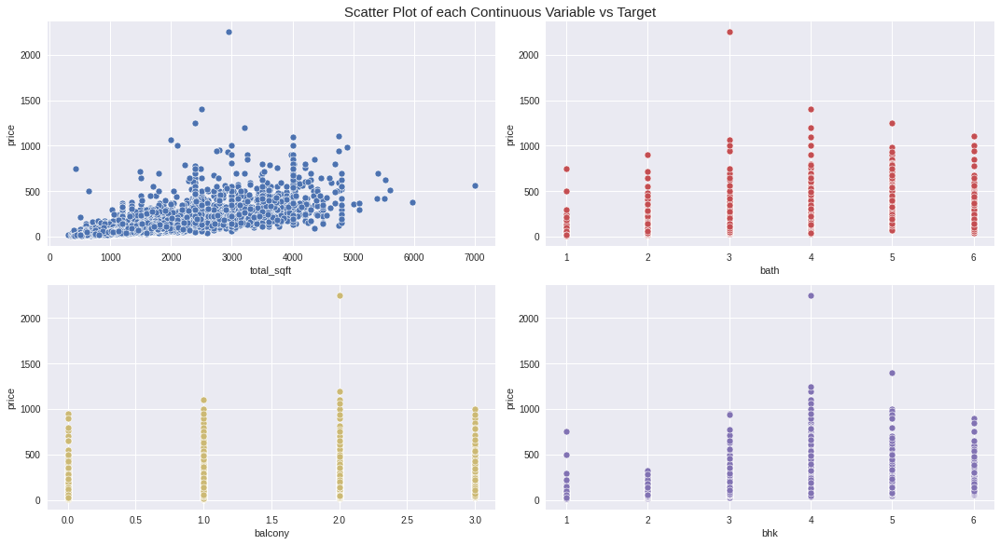

Number of All Scatter Plots = 10


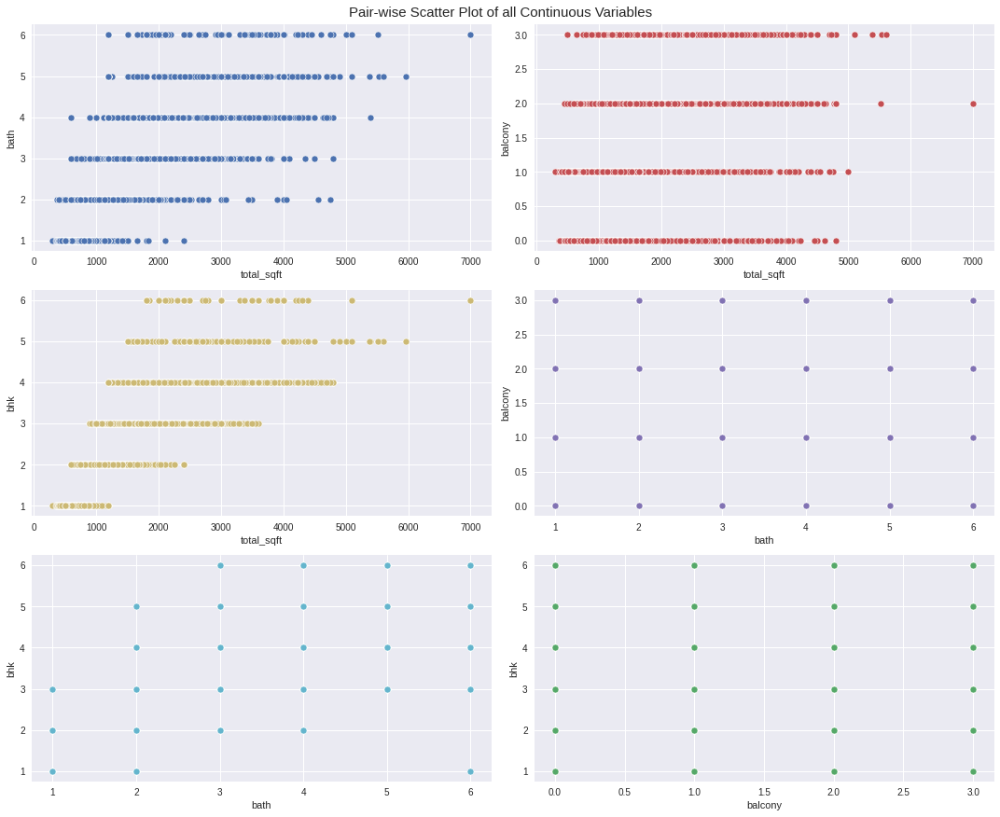

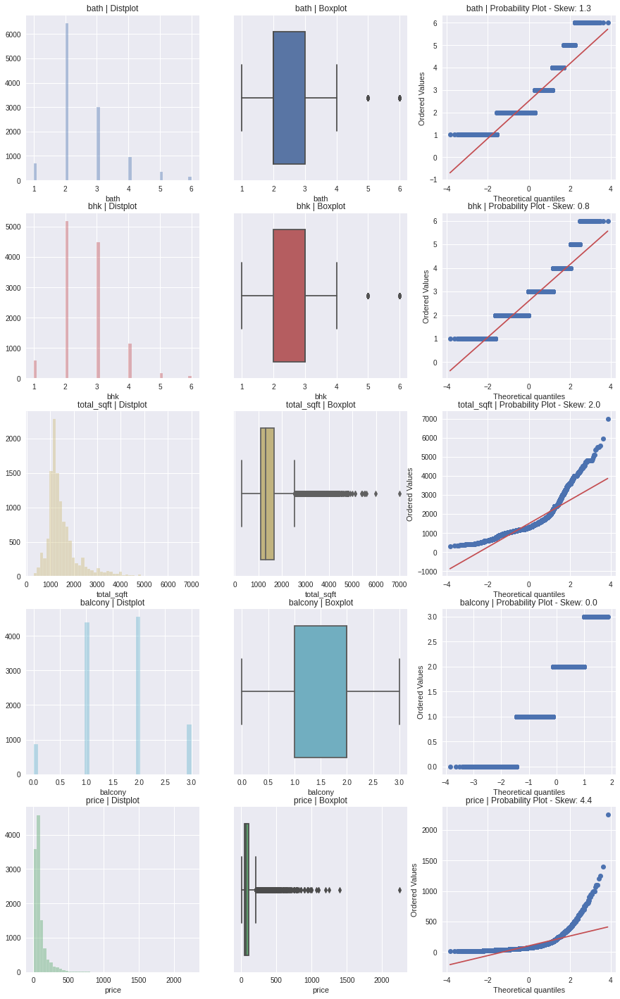

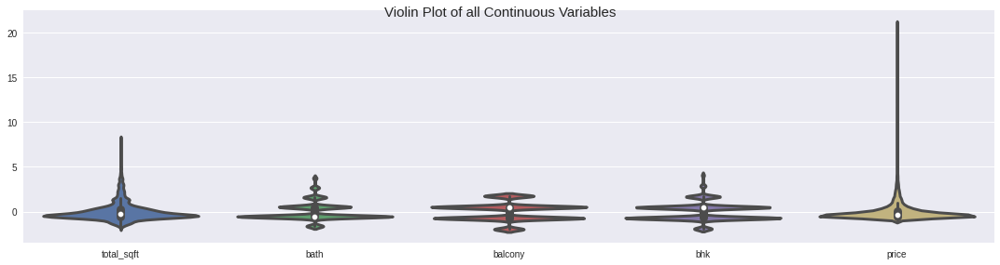

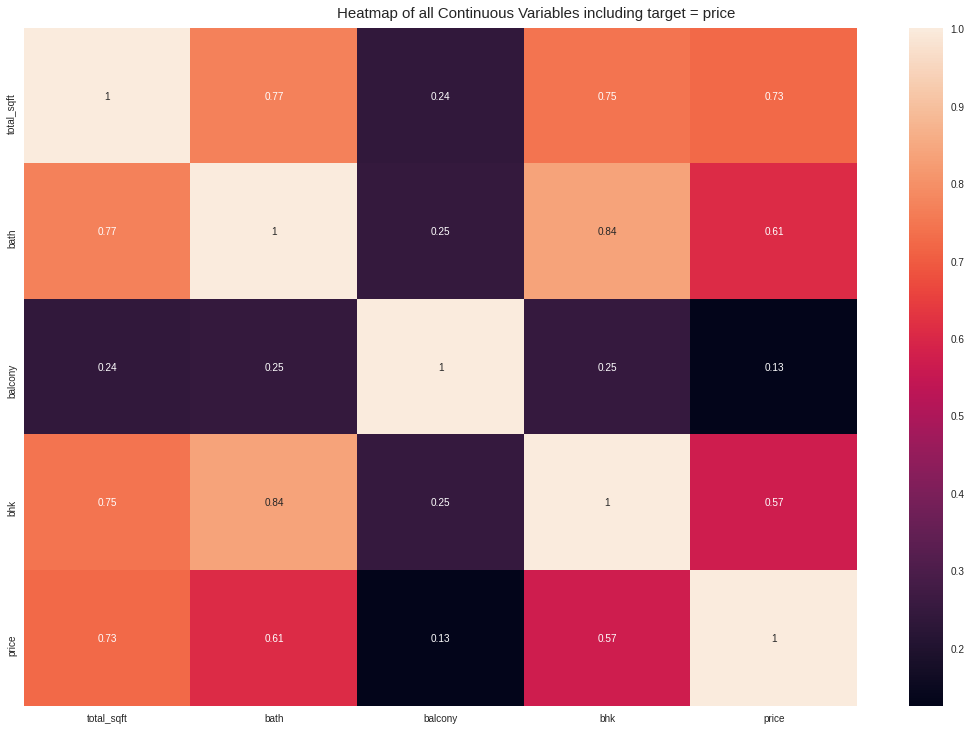

No categorical or boolean vars in data set. Hence no pivot plots...
No categorical or numeric vars in data set. Hence no bar charts.
All Plots done
Time to run AutoViz (in seconds) = 8.697

 ###################### VISUALIZATION Completed ########################


,total_sqft,bath,balcony,bhk,price
0,1056.0,2.0,1.0,2.0,39.07
1,2600.0,5.0,3.0,4.0,120.00
2,1440.0,2.0,3.0,3.0,62.00
3,1521.0,3.0,1.0,3.0,95.00
4,1200.0,2.0,1.0,2.0,51.00
...,...,...,...,...,...
13314,1715.0,3.0,3.0,3.0,112.00
13315,3453.0,4.0,0.0,5.0,231.00
13316,3600.0,5.0,NaN,4.0,400.00
13317,1141.0,2.0,1.0,2.0,60.00


In [59]:
df_auto=df9.drop(['area_type', 'availability','society','price_per_sqft','size'], axis=1)
AV.AutoViz(filename='', sep=',', depVar='price', dfte=df_auto)

columns like 'balcony' is having a low correlation with the price so we just drop it 

In [60]:
df9.rename(columns={"price": "price(in lakhs)"},inplace=True)

In [61]:
df10 = df9[~(df9.total_sqft/df9.bath<300)]
df10.shape

(11580, 11)

In [62]:
report=pandas_profiling.ProfileReport(df10)
report

In [63]:
df11=df10.loc[df10['price_per_sqft'] >=3119.953488]

In [64]:
df12=df11.loc[df11['price_per_sqft'] <=12962.96296]

In [65]:
report=pandas_profiling.ProfileReport(df12)
report

In [66]:
data = df12.sample(frac=0.95, random_state=786)
data_unseen = df12.drop(data.index)
data.reset_index(inplace=True, drop=True)
data_unseen.reset_index(inplace=True, drop=True)
print('Data for Modeling: ' + str(data.shape))
print('Unseen Data For Predictions: ' + str(data_unseen.shape))

Data for Modeling: (9899, 11)
Unseen Data For Predictions: (521, 11)


In [67]:
clf=setup(data=data,target='price(in lakhs)',normalize=True,normalize_method='minmax',remove_multicollinearity=True,ignore_features=['price_per_sqft','availability','society',
'area_type','balcony','size'],remove_outliers=True,high_cardinality_features=['location'])

,Description,Value
0,session_id,3411
1,Target,price(in lakhs)
2,Original Data,"(9899, 11)"
3,Missing Values,True
4,Numeric Features,3
5,Categorical Features,1
6,Ordinal Features,False
7,High Cardinality Features,True
8,High Cardinality Method,frequency
9,Transformed Train Set,"(6582, 4)"


In [68]:
models()

,Name,Reference,Turbo
ID,,,
lr,Linear Regression,sklearn.linear_model._base.LinearRegression,True
lasso,Lasso Regression,sklearn.linear_model._coordinate_descent.Lasso,True
ridge,Ridge Regression,sklearn.linear_model._ridge.Ridge,True
en,Elastic Net,sklearn.linear_model._coordinate_descent.Elast...,True
lar,Least Angle Regression,sklearn.linear_model._least_angle.Lars,True
llar,Lasso Least Angle Regression,sklearn.linear_model._least_angle.LassoLars,True
omp,Orthogonal Matching Pursuit,sklearn.linear_model._omp.OrthogonalMatchingPu...,True
br,Bayesian Ridge,sklearn.linear_model._bayes.BayesianRidge,True
ard,Automatic Relevance Determination,sklearn.linear_model._bayes.ARDRegression,False


In [69]:
compare_models()

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
catboost,CatBoost Regressor,16.8042,623.9669,24.9529,0.7282,0.2527,0.2111,1.525
lightgbm,Light Gradient Boosting Machine,16.8150,641.1415,25.2951,0.7206,0.2532,0.2110,0.076
gbr,Gradient Boosting Regressor,17.3788,652.4125,25.5186,0.7154,0.2585,0.2195,0.238
xgboost,Extreme Gradient Boosting,16.8356,671.5979,25.8688,0.7076,0.2571,0.2106,1.194
rf,Random Forest Regressor,16.9356,699.2768,26.3946,0.6957,0.2644,0.2111,1.062
knn,K Neighbors Regressor,17.9359,742.9832,27.2063,0.6773,0.2705,0.2220,0.067
lr,Linear Regression,19.1882,756.0289,27.4669,0.6703,0.3387,0.2527,0.106
lar,Least Angle Regression,19.1882,756.0290,27.4669,0.6703,0.3387,0.2527,0.013
br,Bayesian Ridge,19.1879,756.0304,27.4669,0.6703,0.3386,0.2527,0.012
ridge,Ridge Regression,19.1967,760.2668,27.5445,0.6688,0.3322,0.2527,0.013


In [70]:
catboost=create_model('catboost')

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,17.2725,701.0264,26.4769,0.6633,0.2565,0.2108
1,17.3818,647.6759,25.4495,0.7277,0.2592,0.2146
2,16.7514,607.3193,24.6438,0.7536,0.2583,0.2157
3,15.6519,531.0826,23.0452,0.7300,0.2425,0.2077
4,16.3077,566.1731,23.7944,0.7645,0.2463,0.2082
5,17.4353,684.2368,26.1579,0.7130,0.2621,0.2142
6,16.9884,599.1848,24.4783,0.7594,0.2530,0.2184
7,15.8525,556.0490,23.5807,0.7109,0.2407,0.1959
8,17.0612,672.9821,25.9419,0.7191,0.2579,0.2129
9,17.3392,673.9392,25.9603,0.7402,0.2506,0.2130


In [71]:
tuned_catboost = tune_model(catboost)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,17.4526,685.3436,26.1791,0.6709,0.2560,0.2124
1,17.6165,659.7586,25.6858,0.7226,0.2640,0.2210
2,17.0296,614.1300,24.7816,0.7508,0.2602,0.2205
3,15.7348,544.0822,23.3256,0.7234,0.2468,0.2112
4,16.6643,584.1177,24.1685,0.7570,0.2499,0.2137
5,18.0057,715.7744,26.7540,0.6997,0.2661,0.2222
6,16.9619,605.6838,24.6106,0.7568,0.2543,0.2202
7,16.3158,579.9281,24.0817,0.6985,0.2480,0.2038
8,17.1653,646.0652,25.4178,0.7303,0.2575,0.2156
9,17.1613,661.2272,25.7143,0.7451,0.2495,0.2128


In [72]:
print(tuned_catboost)

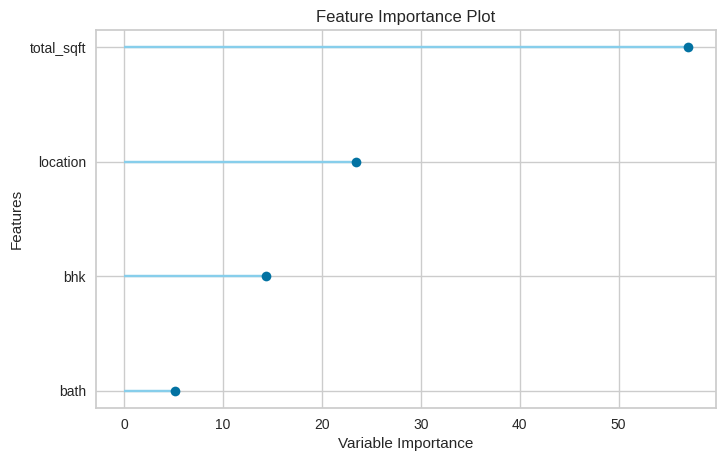

In [73]:
plot_model(tuned_catboost,plot='feature')

In [74]:
report.to_file('/content/Report_bengaluru.html')

In [75]:
data.to_csv('/content/seen_bengaluru.csv')

In [76]:
data_unseen.to_csv('/content/unseen_bengaluru.csv')

In [77]:
final=finalize_model(tuned_catboost)

In [78]:
save_model(final,'final_project_bengaluru')

Transformation Pipeline and Model Succesfully Saved


(Pipeline(memory=None,
          steps=[('dtypes',
                  DataTypes_Auto_infer(categorical_features=[],
                                       display_types=True,
                                       features_todrop=['price_per_sqft',
                                                        'availability',
                                                        'society', 'area_type',
                                                        'balcony', 'size'],
                                       id_columns=[], ml_usecase='regression',
                                       numerical_features=[],
                                       target='price(in lakhs)',
                                       time_features=[])),
                 ('imputer',
                  Simple_Imputer(categorical_strategy='not_avai...
                 ('clean_names', Clean_Colum_Names()),
                 ('feature_select', 'passthrough'),
                 ('fix_multi',
                  Fix_mul

In [79]:
print(tuned_catboost)

In [80]:
predict_unseen=predict_model(final,data=data_unseen)

In [81]:
predict_unseen.head(50)

,area_type,availability,location,size,society,total_sqft,bath,balcony,price(in lakhs),bhk,price_per_sqft,Label
0,Super built-up Area,Ready To Move,Whitefield,2,DuenaTa,1170.00,2.0,1.0,38.00,2.0,3247.863248,56.656877
1,Super built-up Area,19-Dec,Binny Pete,3,She 2rk,1755.00,3.0,1.0,122.00,3.0,6951.566952,117.384051
2,Super built-up Area,Ready To Move,other,1,Ceove G,600.00,1.0,0.0,38.00,1.0,6333.333333,38.037646
3,Super built-up Area,19-Sep,Kanakpura Road,2,Soazak,1330.74,2.0,2.0,91.79,2.0,6897.665960,76.120477
4,Super built-up Area,20-Aug,Begur Road,2,Pruthg,1358.00,2.0,1.0,80.58,2.0,5933.726068,77.158769
5,Super built-up Area,Ready To Move,other,3,NaN,1450.00,2.0,2.0,70.00,3.0,4827.586207,74.475081
6,Super built-up Area,Ready To Move,other,2,Makeser,1007.00,2.0,2.0,43.00,2.0,4270.109235,51.840663
7,Super built-up Area,Ready To Move,Hormavu,2,SyidaCr,1500.00,2.0,1.0,78.00,2.0,5200.000000,86.148698
8,Super built-up Area,Ready To Move,Kothanur,3,Somumys,1828.00,3.0,NaN,110.00,3.0,6017.505470,110.854329
9,Super built-up Area,Ready To Move,Hulimavu,2,Prcan P,1125.00,2.0,2.0,50.00,2.0,4444.444444,54.765817


In [82]:
data_unseen

,area_type,availability,location,size,society,total_sqft,bath,balcony,price(in lakhs),bhk,price_per_sqft
0,Super built-up Area,Ready To Move,Whitefield,2,DuenaTa,1170.00,2.0,1.0,38.00,2.0,3247.863248
1,Super built-up Area,19-Dec,Binny Pete,3,She 2rk,1755.00,3.0,1.0,122.00,3.0,6951.566952
2,Super built-up Area,Ready To Move,other,1,Ceove G,600.00,1.0,0.0,38.00,1.0,6333.333333
3,Super built-up Area,19-Sep,Kanakpura Road,2,Soazak,1330.74,2.0,2.0,91.79,2.0,6897.665960
4,Super built-up Area,20-Aug,Begur Road,2,Pruthg,1358.00,2.0,1.0,80.58,2.0,5933.726068
...,...,...,...,...,...,...,...,...,...,...,...
516,Super built-up Area,18-Apr,EPIP Zone,4,BrontLa,3360.00,5.0,2.0,221.00,4.0,6577.380952
517,Plot Area,18-Jan,other,1,NaN,812.00,1.0,0.0,26.00,1.0,3201.970443
518,Super built-up Area,18-Jul,other,3,Plowsri,1440.00,2.0,2.0,63.93,3.0,4439.583333
519,Super built-up Area,Ready To Move,Sultan Palaya,4,RSntsAp,2200.00,3.0,3.0,80.00,4.0,3636.363636
